In [1]:
#@title Imports
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

In [2]:
#@title Graphing Function

def generate_descent_video(func,trajectory, title="descent", x_range=(-3, 10), y_range=(-3, 10),
                           resolution=20, skip_ratio=100, trajectory_skip=10, frame_duration=100):
  """
  Generates an animated 3D plot of gradient descent.

  Parameters:
  - func: Function to visualize.
  - trajectory: Array of descent points.
  - x_range: Tuple defining x-axis range.
  - y_range: Tuple defining y-axis range.
  - resolution: Number of points for the surface plot.
  - skip_ratio: Number of steps to skip in animation to speed up rendering.
  - trajectory_skip: Number of points to skip when plotting the trajectory to reduce size.
  - frame_duration: Duration of each frame in milliseconds to slow down the animation.
  """
  trajectory = trajectory[::trajectory_skip]

  x_vals = np.linspace(x_range[0], x_range[1], resolution)
  y_vals = np.linspace(y_range[0], y_range[1], resolution)
  X, Y = np.meshgrid(x_vals, y_vals)
  Z = np.array([[func([x, y]) for x, y in zip(x_row, y_row)] for x_row, y_row in zip(X, Y)])

  fig = go.Figure()

  surface = go.Surface(z=Z, x=X, y=Y, colorscale='viridis', opacity=0.8)
  fig.add_trace(surface)

  path_trace = go.Scatter3d(
      x=trajectory[:, 0],
      y=trajectory[:, 1],
      z=[func(p) for p in trajectory],
      mode='lines+markers',
      line=dict(color='red', width=4),
      marker=dict(size=2, color='black'),
      name='Descent Path'
  )
  fig.add_trace(path_trace)

  frames = []
  skip_frames = max(len(trajectory) // skip_ratio, 1)
  for i in range(0, len(trajectory), skip_frames):
    frames.append(go.Frame(
      data=[
        go.Surface(z=Z, x=X, y=Y, colorscale='viridis', opacity=0.8),
        go.Scatter3d(
          x=trajectory[:i+1, 0],
          y=trajectory[:i+1, 1],
          z=[func(p) for p in trajectory[:i+1]],
          mode='lines',
          line=dict(color='red', width=4),
        ),
        go.Scatter3d(
          x=[trajectory[i, 0]],
          y=[trajectory[i, 1]],
          z=[func(trajectory[i])],
          mode='markers',
          marker=dict(size=10, color='blue'),
        )
      ]
    ))

  fig.update_layout(
    title=title,
    scene=dict(
      xaxis_title='x1',
      yaxis_title='x2',
      zaxis_title='f(x1, x2)',
      camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
    ),
    updatemenus=[dict(type='buttons', showactive=True, buttons=[
      dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=frame_duration, redraw=True), fromcurrent=True)])
    ])]
  )

  fig.update(frames=frames)
  return fig

Consider the function  
$$f : \mathbb{R}^2 \rightarrow \mathbb{R}$$  
with  
$$f(x_1, x_2) = (x_1 - 2)^2 + (x_2 - 2)^2 - x_1 x_2.$$

<!-- The constrained optimization problem is:  
$$
\min_{x_1, x_2} f(x_1, x_2) \quad \text{subject to} \quad 0 \leq x_i \leq 1, \; i = 1, 2.
$$ -->

##Normal Gradient Descent##

In [3]:
def func(x):
  return (x[0] - 2)**2 + (x[1]-2)**2 - x[0] * x[1]

def grad_function(x):
  return np.array([2 * (x[0] - 2) - x[1], 2 * (x[1] - 2) - x[0]])

def hessian_function():
  return np.array([[2, -1],[-1, 2]])

In [4]:
def grad_descent(weights=np.random.randn(2), iterations=10000, mu=1e-3):
  """
  Gradient Descent for optimization.
  This method iteratively updates the weights in the direction of the negative gradient
  of the objective function to minimize it.

  Parameters:
  - weights: Initial weights (NumPy array).
  - iterations: Number of iterations to run the gradient descent.
  - mu: Learning rate or step size, controls the size of the update at each step.

  Returns:
  - weights: Optimized weights after all iterations.
  - losses: Array containing the objective function value at each iteration.
  """
  losses = np.zeros(iterations)
  trajectory = [weights.copy()]

  for t in tqdm(range(iterations), desc="Normal Gradient Descent Progress"):
    grad = grad_function(weights)
    weights = weights - mu * grad
    losses[t] = func(weights)
    trajectory.append(weights.copy())

    # gradient close enough
    if np.linalg.norm(grad) < 1e-6:
      break

  return np.array(trajectory), losses

Normal Gradient Descent Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

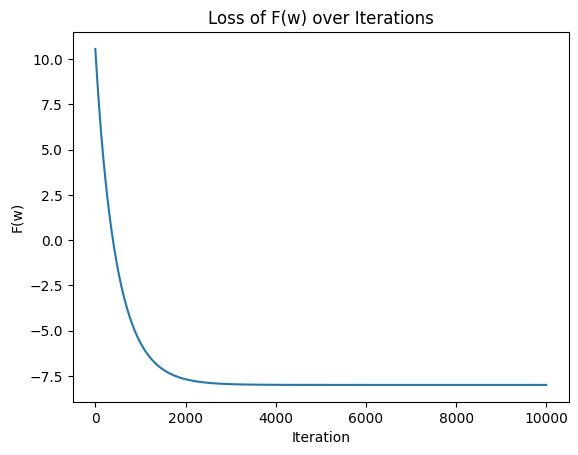

In [5]:
gd_trajectory, loss_gd_values = grad_descent()

plt.plot(loss_gd_values)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of F(w) over Iterations")
plt.show()

In [6]:
gd_fig = generate_descent_video(func, gd_trajectory)
gd_fig.show()

##Newton Method Gradient Descent##

In [7]:
def newton_method(weights=np.random.randn(2), tolerance=1e-6,
iterations=10000, mu=1e-3):
  """
  Newton's Method for optimization.
  This method uses second-order derivatives (Hessian matrix) to update weights iteratively,
  enabling faster convergence for smooth convex functions.

  Parameters:
  - weights: Initial weights (NumPy array).
  - tolerance: Convergence threshold for the gradient norm.
  - iterations: Maximum number of iterations to perform.
  - mu: Step size multiplier to control updates (for stability).

  Returns:
  - trajectory: NumPy array of recorded weight updates.
  - losses: NumPy array of function values at each step.
  """
  hessian = hessian_function()
  try:
    hessian_inv = np.linalg.inv(hessian)
  except np.linalg.LinAlgError:
    print("Hessian not invertible. Using pseudo-inverse.")
    hessian_inv = np.linalg.pinv(hessian)

  trajectory = [weights.copy()]
  losses = [func(weights)]

  for t in tqdm(range(iterations), desc="Newton's Method Progress"):
    grad = grad_function(weights)

    if np.linalg.norm(grad) < tolerance:
      print(f"Converged in {t} iterations.")
      break

    weights = weights - mu * (hessian_inv @ grad)
    trajectory.append(weights.copy())
    losses.append(func(weights))

  return np.array(trajectory), np.array(losses)

Newton's Method Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

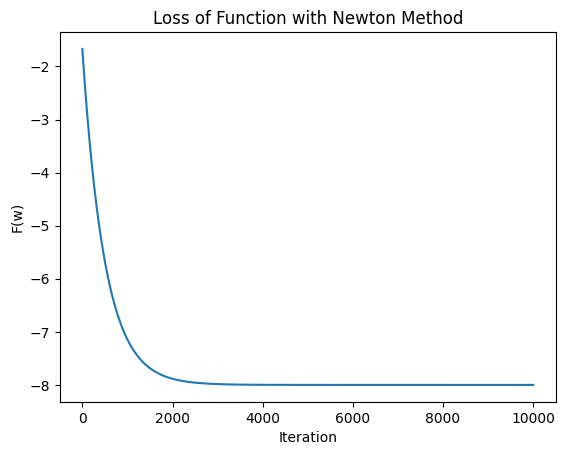

In [8]:
newton_method_trajectory, newton_loss = newton_method()

plt.plot(newton_loss)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of Function with Newton Method")
plt.show()

In [9]:
newton_method_fig = generate_descent_video(func, newton_method_trajectory)
newton_method_fig.show()

##Coordinate Descent##

In [10]:
def coordinate_descent(weights=np.random.randn(2), tolerance=1e-6,
                       iterations=10000, mu=10e-3):
  """
  Coordinate Descent Algorithm.
  This algorithm updates the weights iteratively, focusing on individual coordinates
  based on the largest gradient component (Infinity Norm).

  Parameters:
  - weights: Initial weights (NumPy array).
  - tolerance: Convergence threshold for the norm of the gradient.
  - iterations: Maximum number of iterations to perform.
  - mu: Step size (learning rate).

  Returns:
  - trajectory: NumPy array of recorded weight updates.
  - losses: NumPy array of function values at each step.
  """
  trajectory = [weights.copy()]
  losses = [func(weights)]

  for t in tqdm(range(iterations), desc="Coordinate Descent Progress"):
    grad = grad_function(weights)

    if np.linalg.norm(grad) < tolerance:
      print(f"Converged in {t} iterations.")
      break

    coord = np.argmax(np.abs(grad))
    weights[coord] -= mu * np.sign(grad[coord])

    trajectory.append(weights.copy())
    losses.append(func(weights))

  return np.array(trajectory), np.array(losses)

Coordinate Descent Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

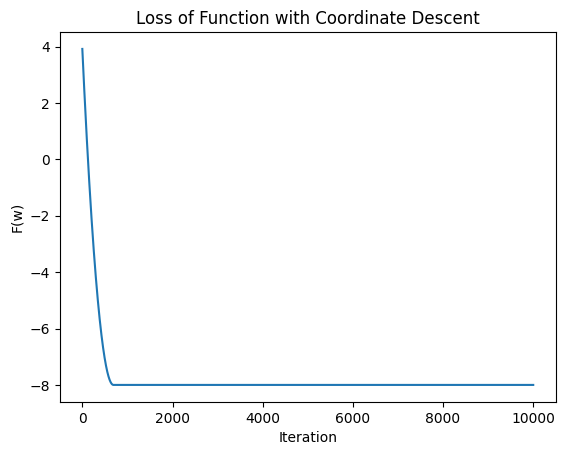

In [11]:
cd_trajectory, cd_loss = coordinate_descent()

plt.plot(cd_loss)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of Function with Coordinate Descent")
plt.show()

In [12]:
cd_fig = generate_descent_video(func, cd_trajectory)
cd_fig.show()

##L-1 Norm Gradient Descent##

In [13]:
def l1_norm_descent(weights=np.random.randn(2), tolerance=1e-6, iterations=10000,
                    mu=10e-3, lambda_reg=1e-2):
  """
  L1-Norm Descent Algorithm.
  This algorithm updates the weights iteratively while applying L1 regularization (Lasso-type descent).

  Parameters:
  - weights: Initial weights (NumPy array).
  - tolerance: Convergence threshold for the norm of the gradient.
  - iterations: Maximum number of iterations to perform.
  - mu: Step size (learning rate).
  - lambda_reg: Regularization strength (L1 penalty factor).

  Returns:
  - trajectory: NumPy array of recorded weight updates.
  - losses: NumPy array of function values at each step.
  """
  trajectory = [weights.copy()]
  losses = [func(weights)]

  for t in tqdm(range(iterations), desc="L1-Norm Descent Progress"):
    grad = grad_function(weights)

    if np.linalg.norm(grad) < tolerance:
      print(f"Converged in {t} iterations.")
      break

    weights -= mu * (grad + lambda_reg * np.sign(weights))

    trajectory.append(weights.copy())
    losses.append(func(weights))

  return np.array(trajectory), np.array(losses)

L1-Norm Descent Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

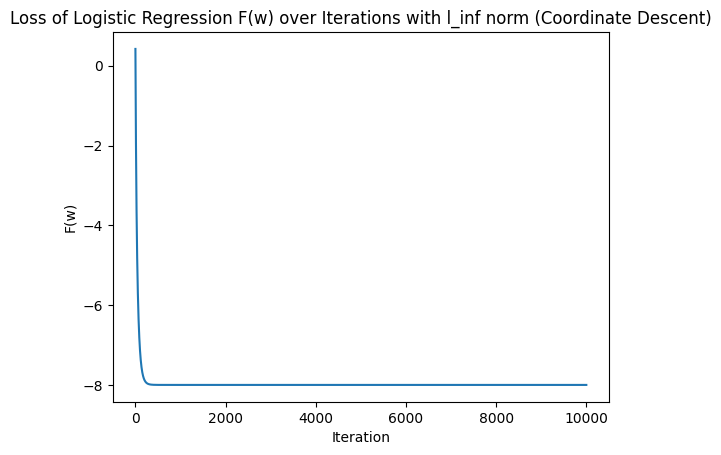

In [14]:
l1_trajectory, loss_l1 = l1_norm_descent()

plt.plot(loss_l1)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of Logistic Regression F(w) over Iterations with l_inf norm (Coordinate Descent)")
plt.show()

In [15]:
l1_fig = generate_descent_video(func, l1_trajectory)
l1_fig.show()

##Backtracking Line Search with Armijo Condition##

In [16]:
def backtracking_line_search(weights=np.random.randn(2), tolerance=1e-6, iterations=10000,
                             mu_init=1, beta=0.5, gamma=0.1):
  """
  Backtracking Line Search with Armijo condition.

  Parameters:
  - weights: Initial weights or point (NumPy array).
  - tolerance: Convergence criterion for gradient norm.
  - iterations: Maximum number of iterations.
  - mu_init: Initial step size.
  - beta: Step size reduction factor (0 < beta < 1).
  - gamma: Parameter for Armijo condition.

  Returns:
  - trajectory: NumPy array of recorded weight updates.
  - losses: NumPy array of function values at each step.
  """
  mu = mu_init
  trajectory = [weights.copy()]
  losses = [func(weights)]

  for i in tqdm(range(iterations), desc="Backtracking Line Search Progress"):
    grad = grad_function(weights)
    grad_norm = np.linalg.norm(grad)

    if grad_norm < tolerance:
      print(f"Converged in {i} iterations.")
      break

    # Armijo condition
    while func(weights - mu * grad) > func(weights) - mu * gamma * grad_norm**2:
      mu *= beta

    weights = weights - mu * grad
    trajectory.append(weights.copy())
    losses.append(func(weights))

  return np.array(trajectory), np.array(losses)

Backtracking Line Search Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

Converged in 22 iterations.


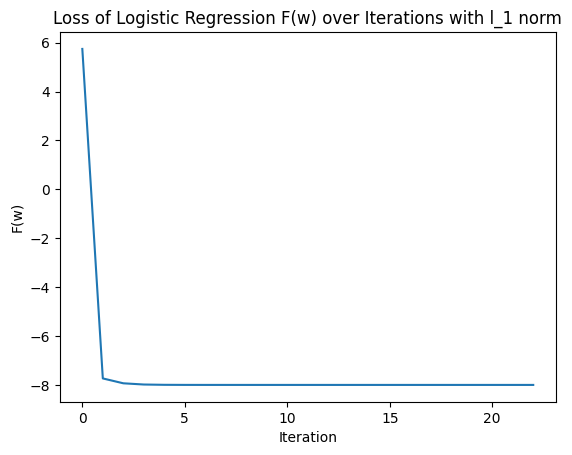

In [17]:
backtracking_linesearch_trajectory, losses_backtracking = backtracking_line_search()

plt.plot(losses_backtracking)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of Logistic Regression F(w) over Iterations with l_1 norm")
plt.show()

In [18]:
backtrack_fig = generate_descent_video(func, backtracking_linesearch_trajectory)
backtrack_fig.show()

##Gradient Descent with Momentum##

In [19]:
def gradient_descent_momentum(weights=np.random.randn(2), mu=1e-1, beta=0.8, iterations=10000):
  """
  Gradient Descent with Momentum for optimization.
  This method accelerates convergence by incorporating a momentum term
  that smooths updates and avoids oscillations.

  Parameters:
  - weights: Initial weights (NumPy array), default is random initialization.
  - mu: Learning rate (float), controls the size of weight updates.
  - beta: Momentum coefficient (float), determines the impact of the previous update.
  - iterations: Number of iterations to perform (int).

  Returns:
  - trajectory: NumPy array of recorded weight updates.
  - losses: NumPy array of function values at each step.
  """
  trajectory = [weights.copy()]
  losses = np.zeros(iterations)
  momentum = np.zeros_like(weights)

  for i in tqdm(range(iterations), desc="Gradient Descent with Momentum Progress"):
    grad = grad_function(weights)
    momentum = beta * momentum - mu * grad
    weights = weights + momentum

    trajectory.append(weights.copy())
    losses[i] = func(weights)

  return np.array(trajectory), np.array(losses)

Gradient Descent with Momentum Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

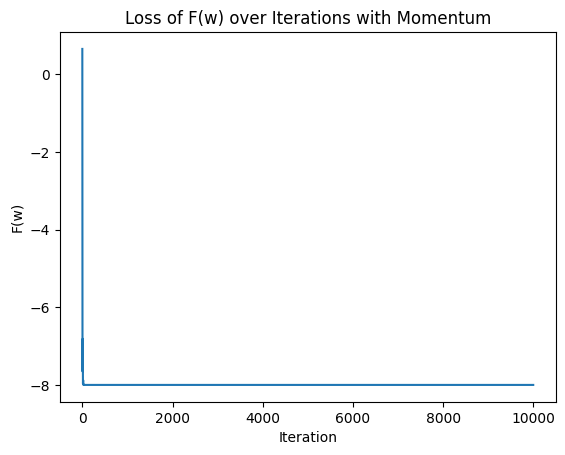

In [20]:
gd_momentum_trajectory, loss_gd_momentum = gradient_descent_momentum()

plt.plot(loss_gd_momentum)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of F(w) over Iterations with Momentum")
plt.show()

In [21]:
momentum_fig = generate_descent_video(func, gd_momentum_trajectory)
momentum_fig.show()

##Gradient Descent with Nesterov's Acceleration##

In [25]:
def gradient_descent_nesterov(weights=np.random.randn(2), mu=1e-1, beta=0.8, iterations=10000):
  """
  Nesterov Accelerated Gradient Descent (NAG).
  This optimization technique improves convergence speed by "looking ahead"
  using a combination of momentum and gradient descent.

  Parameters:
  - weights: Initial weights (NumPy array), default is random initialization.
  - mu: Learning rate (float), controls the size of weight updates.
  - beta: Momentum coefficient (float), determines the impact of previous updates.
  - iterations: Number of iterations to perform (int).

  Returns:
  - trajectory: NumPy array of recorded weight updates.
  - losses: NumPy array of function values at each step.
  """
  trajectory = [weights.copy()]
  losses = np.zeros(iterations)
  momentum = np.zeros_like(weights)

  for i in tqdm(range(iterations), desc="Nesterov Accelerated Gradient Descent Progress"):
    lookahead_weights = weights + beta * momentum
    grad = grad_function(lookahead_weights)
    new_momentum = beta * momentum - mu * grad

    weights = weights + new_momentum
    momentum = new_momentum

    trajectory.append(weights.copy())
    losses[i] = func(weights)

  return np.array(trajectory), np.array(losses)

Nesterov Accelerated Gradient Descent Progress:   0%|          | 0/10000 [00:00<?, ?it/s]

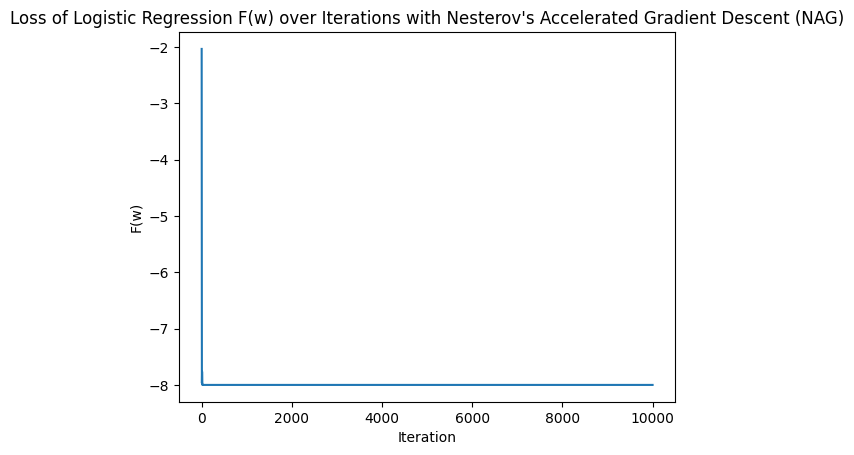

In [28]:
nesterov_trajectory, loss_gd_nesterov = gradient_descent_nesterov()

plt.plot(loss_gd_nesterov)
plt.xlabel("Iteration")
plt.ylabel("F(w)")
plt.title("Loss of Logistic Regression F(w) over Iterations with Nesterov's Accelerated Gradient Descent (NAG)")
plt.show()

In [29]:
nesterov_fig = generate_descent_video(func, nesterov_trajectory)
nesterov_fig.show()